In [1]:

from pathlib import Path

import numpy as np
import torch
from torch.utils.data import DataLoader, DistributedSampler


import datasets
import util.misc as utils
from datasets import build_dataset, get_coco_api_from_dataset
from engine import evaluate, train_one_epoch
from models import build_model

from models.detr import SetCriterion
from torch import nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import torchvision.transforms as T
import argparse

import math
from PIL import Image
import requests
import random

import pickle


#------------------------------------------------------------------------


def get_args_parser():
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--lr', default=1e-4, type=float)
    parser.add_argument('--lr_backbone', default=1e-5, type=float)
    parser.add_argument('--batch_size', default=2, type=int)
    parser.add_argument('--weight_decay', default=1e-4, type=float)
    parser.add_argument('--epochs', default=300, type=int)
    parser.add_argument('--lr_drop', default=200, type=int)
    parser.add_argument('--clip_max_norm', default=0.1, type=float,
                        help='gradient clipping max norm')

    # Model parameters
    parser.add_argument('--frozen_weights', type=str, default=None,
                        help="Path to the pretrained model. If set, only the mask head will be trained")
    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")

    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer")
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=100, type=int,
                        help="Number of query slots")
    parser.add_argument('--pre_norm', action='store_true')

    
    ####################### @amirhnazerii #######################
    ##### start 03/27/2025
    # * Classification head
    parser.add_argument('--new_layer_dim', default=None, type=int,
                        help="classification head added fc-layer dim")
    parser.add_argument('--num_classes', type=int, default=None,
                        help="Number of classes in dataset+1")
    
    # * Segmentation
    parser.add_argument('--masks', action='store_true',
                        help="Train segmentation head if the flag is provided")

    # Loss
    parser.add_argument('--no_aux_loss', dest='aux_loss', action='store_false',
                        help="Disables auxiliary decoding losses (loss at each layer)")
    # * Matcher
    parser.add_argument('--set_cost_class', default=1, type=float,
                        help="Class coefficient in the matching cost")
    parser.add_argument('--set_cost_bbox', default=5, type=float,
                        help="L1 box coefficient in the matching cost")
    parser.add_argument('--set_cost_giou', default=2, type=float,
                        help="giou box coefficient in the matching cost")
    # * Loss coefficients
    parser.add_argument('--mask_loss_coef', default=1, type=float)
    parser.add_argument('--dice_loss_coef', default=1, type=float)
    parser.add_argument('--bbox_loss_coef', default=5, type=float)
    parser.add_argument('--giou_loss_coef', default=2, type=float)
    parser.add_argument('--eos_coef', default=0.1, type=float,
                        help="Relative classification weight of the no-object class")

    # dataset parameters
    parser.add_argument('--dataset_file', default='coco')
    parser.add_argument('--coco_path', type=str)
    parser.add_argument('--coco_panoptic_path', type=str)
    parser.add_argument('--remove_difficult', action='store_true')

    parser.add_argument('--output_dir', default='',
                        help='path where to save, empty for no saving')
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    parser.add_argument('--seed', default=42, type=int)
    parser.add_argument('--resume', default='', help='resume from checkpoint')
    parser.add_argument('--start_epoch', default=0, type=int, metavar='N',
                        help='start epoch')
    parser.add_argument('--eval', action='store_true')
    parser.add_argument('--num_workers', default=2, type=int)

    # distributed training parameters
    parser.add_argument('--world_size', default=1, type=int,
                        help='number of distributed processes')
    parser.add_argument('--dist_url', default='env://', help='url used to set up distributed training')
    
    
    # robustness param:
    parser.add_argument('--robust', default=False, type=bool,
                        help='nrobust detr training with modified loss function.')
 
    
    return parser


#------------------------------------------------------------------------





In [2]:
parser = argparse.ArgumentParser('DETR training and evaluation script', parents=[get_args_parser()])
args = parser.parse_args(args=['--resume', '/home/anazeri/detr_finetune/detr-orighead-r50-cityscapes-finetune-v2-70epch/checkpoint0061.pth',
                              '--coco_path', "/scratch/anazeri/cityscapes_coco",
                              '--num_classes', "8",
                            '--device', 'cuda',
                              ])
args.batch_size = 1
args.no_aux_loss = True
args.eval = True



# args.resume = 'https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth'
# args.resume = '/scratch/anazeri/outputs11202023_R50_kitti_imgs6481_epch25/eval/checkpoint.pth'
# args.coco_path = '/scratch/anazeri/kitti_coco_format/kitti_val/'

In [3]:
args.device = 'cuda'   
seed = args.seed + utils.get_rank()
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)    

In [28]:
# COCO classes
# CLASSES = ["person", "Cyclist", "DontCare", "Misc", "Pedestrian",
# "Person_sitting", "Tram", "Truck", "Van"]
 
CLASSES = [
    'background', 
    'person', 
    'rider', 
    'car', 
    'truck', 
    'bus', 
    'train', 
    'motorcycle', 
    'bicycle'
]

# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]



# standard PyTorch mean-std input image normalization
transform = T.Compose([
    # T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size, device):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32).to(device)
    return b


def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16*2,10*2))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        mask = [True if int(cl) == 8 else False]
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    print(f'id=8 exists? {np.sum(mask)}')
    plt.axis('off')
    plt.show()



def ObjDet_one_img(model, im, args):
    
    # mean-std normalize the input image (batch-size: 1)
    img = transform(im).unsqueeze(0)
    img = img.to(args.device)
    # propagate through the model
    outputs = model(img)

    # keep only predictions with 0.5+ confidence
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > 0.5

    # convert boxes from [0; 1] to image scales
    # device = 'cuda'
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size, args.device)

    return plot_results(im, probas[keep], bboxes_scaled)    
    

In [9]:
args.resume = "/home/anazeri/detr_finetune/detr-orighead-r50-cityscapes-finetune-v2-70epch/checkpoint0061.pth"
model, criterion, postprocessors = build_model(args)
model.to(args.device)
model_without_ddp = model
n_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print('number of params:', n_parameters)

if args.resume:
    if args.resume.startswith('https'):
        checkpoint = torch.hub.load_state_dict_from_url(
            args.resume, map_location='cpu', check_hash=True)
    else:
        checkpoint = torch.load(args.resume, map_location='cpu')

    model_without_ddp.load_state_dict(checkpoint['model'])


for param in model.parameters():
    param.requires_grad = False
    


number of params: 41281037


tensor(3, device='cuda:0')
tensor(3, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(2, device='cuda:0')
tensor(4, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(3, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(7, device='cuda:0')
tensor(3, device='cuda:0')
tensor(5, device='cuda:0')
tensor(3, device='cuda:0')
tensor(5, device='cuda:0')


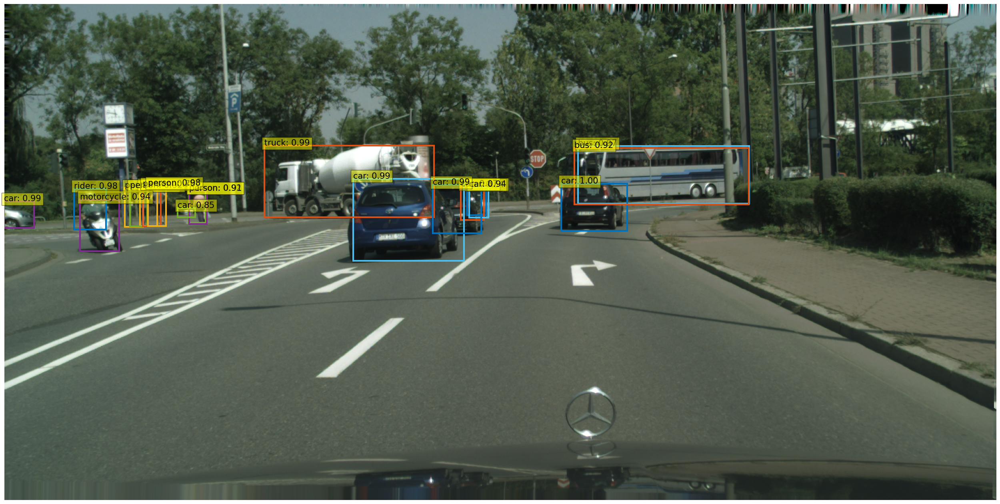

In [10]:
PATH_imgs = ["/scratch/anazeri/cityscapes_coco/val2017/000000000013.png", 

            ]
for PATH_img in PATH_imgs:
    
    im = Image.open(PATH_img) 
    ObjDet_one_img(model, im, args)

tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(3, device='cuda:0')
tensor(2, device='cuda:0')
tensor(4, device='cuda:0')
tensor(1, device='cuda:0')
tensor(2, device='cuda:0')
tensor(3, device='cuda:0')
tensor(7, device='cuda:0')
tensor(4, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(4, device='cuda:0')
tensor(3, device='cuda:0')
tensor(4, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(1, device='cuda:0')
tensor(1, device='cuda:0')
tensor(7, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(1, device='cuda:0')
tensor(3, device='cuda:0')
tensor(3, device='cuda:0')
tensor(3, device='cuda:0')
tensor(2, device='cuda:0')
t

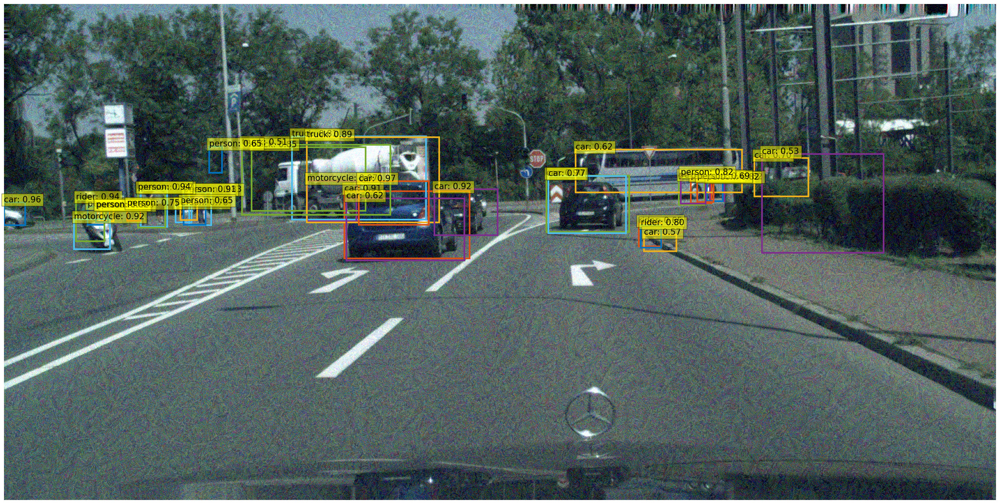

In [11]:
PATH_imgs = ["/scratch/anazeri/pgd/cityscapes/cityscapes_origsiz_SavImg_detr_DETR_r50_pgd_05_iters100_stepsize02/000000000013.png", 

            ]
for PATH_img in PATH_imgs:
    
    im = Image.open(PATH_img) 
    ObjDet_one_img(model, im, args)

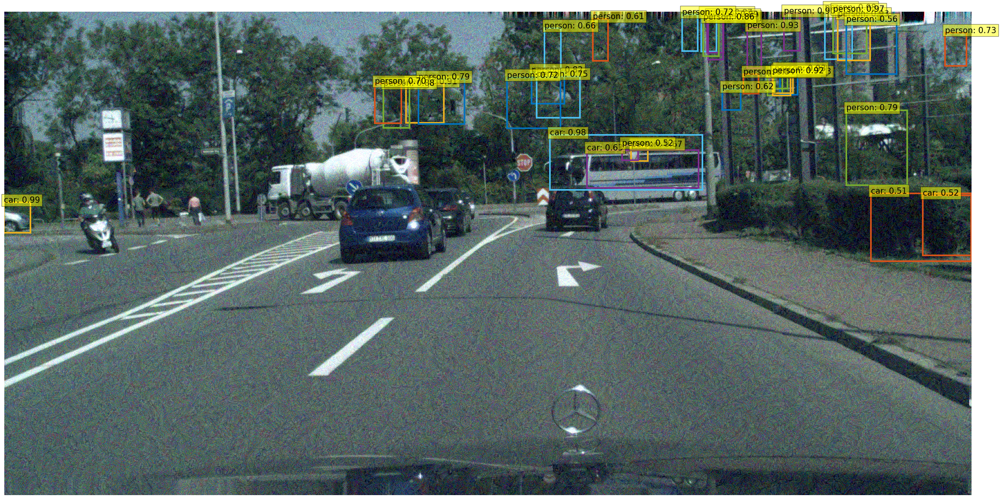

In [19]:
PATH_imgs = ["/scratch/anazeri/dag/cityscapes/cityscapes_origsiz_SavImg_detr_DETR_r50_dag_05_iters100_stepsize02_target_class_1/000000000013.png", 

            ]
for PATH_img in PATH_imgs:
    
    im = Image.open(PATH_img) 
    ObjDet_one_img(model, im, args)

In [7]:
model, criterion, postprocessors = build_model(args)

/home/anazeri/.conda/envs/Detr_env1/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/anazeri/.conda/envs/Detr_env1/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [21]:
next(model.parameters()).device

device(type='cuda', index=0)

id=8 exists? 0


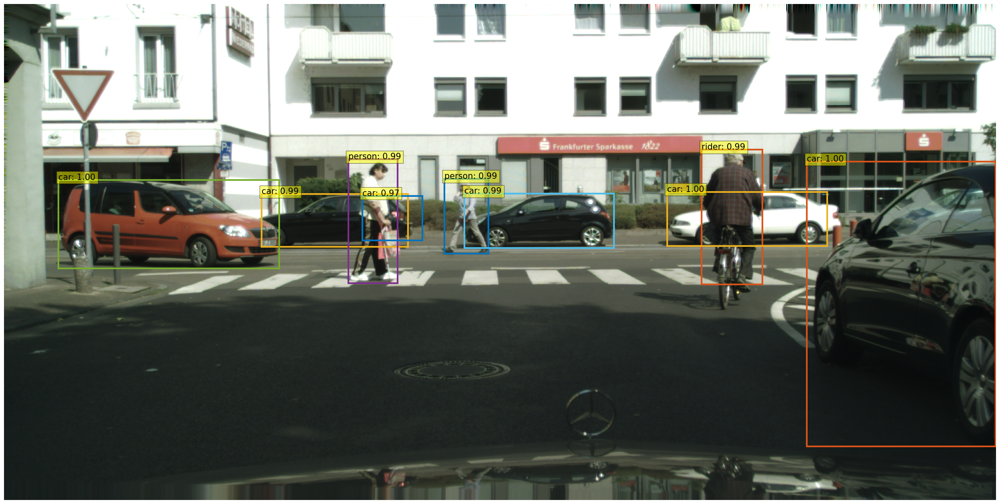

id=8 exists? 0


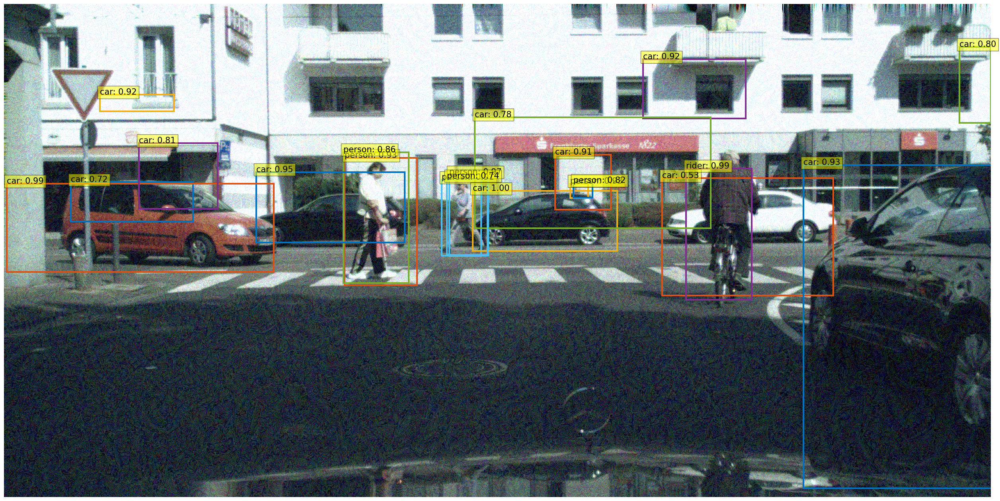

In [30]:
PATH_imgs = ["/scratch/anazeri/cityscapes_coco/val2017/000000000003.png",
             "/scratch/anazeri/pgd/cityscapes/cityscapes_origsiz_SavImg_detr_DETR_r50_pgd_05_iters100_stepsize02/000000000003.png", 
            ]
for PATH_img in PATH_imgs:
    
    im = Image.open(PATH_img) 
    ObjDet_one_img(model, im, args)